In [12]:
from maggeometry import noisy_halbach_cylinder, halbach_cylinder
from maghelper import get_field_on_axes, get_nonuniformity, make_flux_stream, get_grid_nonuniformity, make_xy_grid, get_grid_mag_and_nonuniformity
import numpy as np
import matplotlib.pyplot as plt

In [13]:
# Nominal best SW Halbach result
D = 69.6866820638743
c_d = 1
c_h = 640
n = 9
Br = 1.09e3

## height experiment

In [19]:
grid_res = 101
grid = make_xy_grid([-10, 10], [-10, 10], grid_res)
h = np.arange(20, 640 + 20, 20)
nonun = []
for i in h:
    magnets = halbach_cylinder(Br, c_d, i, D, n, alternate=False)
    Gmag, Gnon, center_field, av_nonuniformity, max_abs_nonuniformity = get_grid_mag_and_nonuniformity(magnets, grid, grid_res)
    nonun.append(av_nonuniformity)
print(nonun)

[0.04859082924120334, 0.028264015333431793, 0.013580421903339936, 0.006121036287612156, 0.002784321001350672, 0.0013202840664775463, 0.000659568074349189, 0.00034734352710950997, 0.0001921700525977421, 0.00011117227240912716, 6.692608024405354e-05, 4.1738298279342644e-05, 2.6858386197438432e-05, 1.7771171383209975e-05, 1.2054011145586639e-05, 8.359755659193226e-06, 5.914569527831455e-06, 4.2606092838943315e-06, 3.119628217875112e-06, 2.3183244928359353e-06, 1.7463103054635148e-06, 1.3318362389541183e-06, 1.027379573572917e-06, 8.008681778916096e-07, 6.303791175609942e-07, 5.006388357533486e-07, 4.009468793270559e-07, 3.2362832654127545e-07, 2.631354587303998e-07, 2.153678491605676e-07, 1.7740215189501824e-07, 1.4697658241310967e-07]


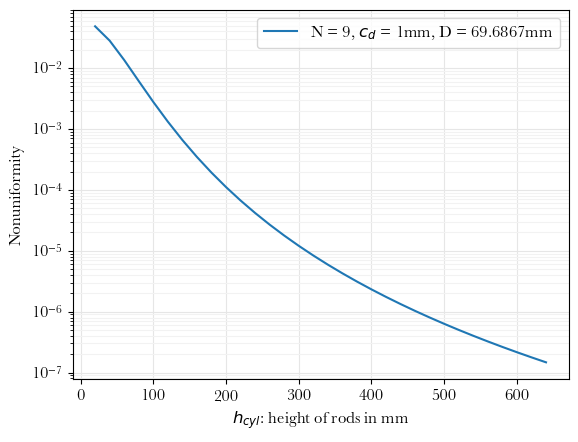

In [31]:
plt.rcParams["font.family"] = 'Baskerville'
plt.yscale('log')
plt.ylabel('Nonuniformity')
plt.xlabel(r'$h_{cyl}$: height of rods in mm')
plt.grid(color='.9', which='major', axis='both', linestyle='-')
plt.grid(color='.95', which='minor', axis='both', linestyle='-')
plt.plot(h, nonun, label=r'N = 9, $c_d$ = 1mm, D = 69.6867mm')
plt.legend()
plt.savefig('figs/halbachchdependence.png', dpi=500)

In [20]:
print(h)

[ 20  40  60  80 100 120 140 160 180 200 220 240 260 280 300 320 340 360
 380 400 420 440 460 480 500 520 540 560 580 600 620 640]


In [16]:
magnets = halbach_cylinder(Br, c_d, 640, D, n, alternate=False)
Gmag, Gnon, center_field, av_nonuniformity, max_abs_nonuniformity = get_grid_mag_and_nonuniformity(magnets, grid, grid_res)
print(av_nonuniformity)

1.4697658241310967e-07


## simulation of tolerances

In [47]:
alphabet = np.linspace(0, 2, 20)

In [51]:
dbr = 0.02e3
ddeg = 2
dposd = 2
D = 69.6866820638743
c_d = 1
c_h = 640
n = 9
Br = 1.09e3
mean_cyl_deg = 0
mean_pos_deg = 0
allnonun=[]
allfield=[]
shots = 20
grid_res = 101
grid = make_xy_grid([-10, 10], [-10, 10], grid_res)
for alpha in alphabet:
    nonun = []
    field = []
    for i in range(shots):
        sd_Br = alpha * dbr
        sd_cdeg = alpha * ddeg
        sd_pdeg = alpha * dposd
        magnets = noisy_halbach_cylinder(Br, sd_Br, c_d, c_h, D, n, mean_cyl_deg, sd_cdeg, mean_pos_deg, sd_pdeg, alternate=False)
        Gmag, Gnon, center_field, av_nonuniformity, max_abs_nonuniformity = get_grid_mag_and_nonuniformity(magnets, grid, grid_res)
        nonun.append(av_nonuniformity)
        field.append(center_field)
    allnonun.append(nonun)
    allfield.append(field)
print(allnonun, allfield)

[[1.4697658241310967e-07, 1.4697658241310967e-07, 1.4697658241310967e-07, 1.4697658241310967e-07, 1.4697658241310967e-07, 1.4697658241310967e-07, 1.4697658241310967e-07, 1.4697658241310967e-07, 1.4697658241310967e-07, 1.4697658241310967e-07, 1.4697658241310967e-07, 1.4697658241310967e-07, 1.4697658241310967e-07, 1.4697658241310967e-07, 1.4697658241310967e-07, 1.4697658241310967e-07, 1.4697658241310967e-07, 1.4697658241310967e-07, 1.4697658241310967e-07, 1.4697658241310967e-07], [0.000670354812043971, 0.0005797789628714205, 0.0015490122254801677, 0.0007442346525212826, 0.00011557625176332326, 0.00048379386610807436, 0.00029980147953621763, 0.0003232374912596716, 0.002954509056036634, 0.0006639302710334144, 0.0005801144891031286, 0.0007699458375913017, 0.001089247857912503, 0.0006803304132104383, 0.000795757351985695, 0.0004296886095658508, 0.00033834834343912423, 0.0005635990042505122, 0.0005277366525533696, 0.0005322285995216107], [0.0012330406695408127, 0.000352152824253357, 0.0013345

In [58]:
alphabet = np.linspace(0, 2, 21)
dbr = 0.02e3
ddeg = 2
dposd = 2
D = 69.6866820638743
c_d = 1
c_h = 640
n = 9
Br = 1.09e3
mean_cyl_deg = 0
mean_pos_deg = 0
allnonun=[]
allfield=[]
shots = 20
grid_res = 101
grid = make_xy_grid([-10, 10], [-10, 10], grid_res)
for alpha in alphabet:
    nonun = []
    field = []
    for i in range(shots):
        sd_Br = alpha * dbr
        sd_cdeg = alpha * ddeg
        sd_pdeg = alpha * dposd
        magnets = noisy_halbach_cylinder(Br, sd_Br, c_d, c_h, D, n, mean_cyl_deg, sd_cdeg, mean_pos_deg, sd_pdeg, alternate=False)
        Gmag, Gnon, center_field, av_nonuniformity, max_abs_nonuniformity = get_grid_mag_and_nonuniformity(magnets, grid, grid_res)
        nonun.append(av_nonuniformity)
        field.append(center_field)
    allnonun.append(nonun)
    allfield.append(field)
print(allnonun, allfield)

[[1.4697658241310967e-07, 1.4697658241310967e-07, 1.4697658241310967e-07, 1.4697658241310967e-07, 1.4697658241310967e-07, 1.4697658241310967e-07, 1.4697658241310967e-07, 1.4697658241310967e-07, 1.4697658241310967e-07, 1.4697658241310967e-07, 1.4697658241310967e-07, 1.4697658241310967e-07, 1.4697658241310967e-07, 1.4697658241310967e-07, 1.4697658241310967e-07, 1.4697658241310967e-07, 1.4697658241310967e-07, 1.4697658241310967e-07, 1.4697658241310967e-07, 1.4697658241310967e-07], [0.00042449725479624354, 0.00034465216475409126, 0.001150672365081958, 0.0008925070547434244, 0.0003290960357382312, 0.00023553539358429435, 0.0010839399990216962, 0.0006654979388718049, 0.0006525109530718803, 0.0010024060436938159, 0.0005498461943449466, 0.0010391772566602946, 0.0013351126901798075, 0.001481594814599184, 0.000456764569539441, 0.00013579548867799255, 0.000396920751110482, 0.00029156196222162727, 0.0005467280047287309, 0.0014500538984102069], [0.0013472116327366182, 0.0010195350075042605, 0.00109

[1.4697658241310967e-07, 0.0006011785737084134, 0.0010589290838639792, 0.0014981547819070714, 0.0018984367143634706, 0.003652712864311244, 0.004119805153619999, 0.003414374237289678, 0.003346913847003718, 0.0035971469272290547, 0.0061289126001440215, 0.006193118828552653, 0.005739286220212279, 0.00802872188164531, 0.008728685523884427, 0.00898876808634418, 0.00872259419813955, 0.010305591056227737, 0.012418235591174397, 0.01026545969900672, 0.016092045648148298]


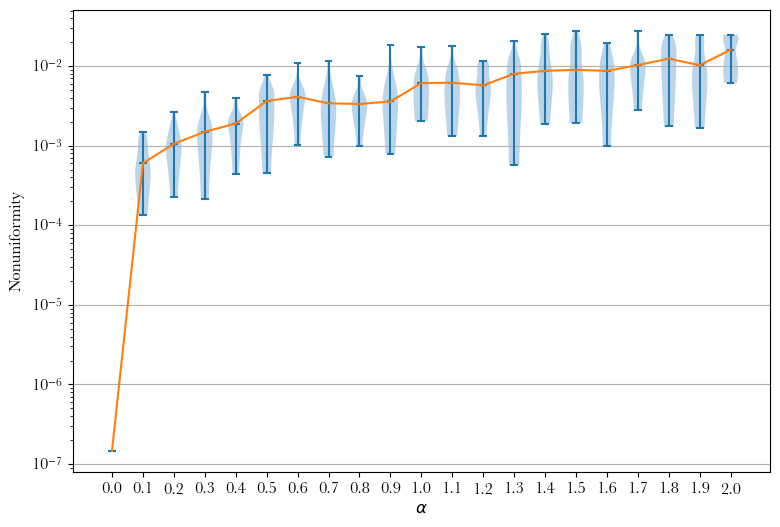

In [75]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(9, 6))
# generate some random test data
all_data = allnonun

medians = [np.median(i) for i in all_data]
# plot violin plot
ax.violinplot(all_data,
                  showmeans=False,
                  showmedians=True)

# adding horizontal grid lines
ax.yaxis.grid(True)
ax.set_xticks([y + 1 for y in range(len(all_data))],
              labels=np.round(alphabet, 2))
ax.set_xlabel(r'$\alpha$')
ax.set_ylabel('Nonuniformity')
ax.set_yscale('log')
print(medians)
ax.plot(np.arange(1,22), medians)
plt.savefig('figs/halbachtolerancenonun.png', dpi=500)

[10.09989803807991, 10.098343373395231, 10.09999941032116, 10.093377178814126, 10.102824071890833, 10.10316326893685, 10.091178012787003, 10.076607064077029, 10.09330446523727, 10.084871122145554, 10.068689539825694, 10.062158984801538, 10.056968293141656, 10.051397381202204, 10.057692878877617, 10.015769387834784, 10.015659673714033, 10.007331219918528, 10.002454143229336, 10.01844182042385, 9.98398587057563]


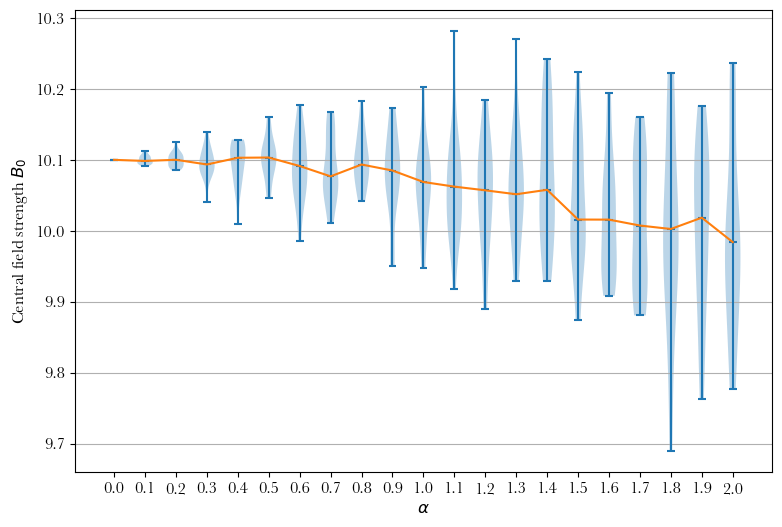

In [76]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(9, 6))
# generate some random test data
all_data = allfield

medians = [np.median(i) for i in all_data]
# plot violin plot
ax.violinplot(all_data,
                  showmeans=False,
                  showmedians=True)

# adding horizontal grid lines
ax.yaxis.grid(True)
ax.set_xticks([y + 1 for y in range(len(all_data))],
              labels=np.round(alphabet, 2))
ax.set_xlabel(r'$\alpha$')
ax.set_ylabel(r'Central field strength $B_0$')
# ax.set_yscale('log')
print(medians)
ax.plot(np.arange(1,22), medians)
plt.savefig('figs/halbachtolerancefield.png', dpi=500)

In [ ]:
pp1names = [f'results/halbach/pippin/run1/st1/h{n}.csv' for n in range (6,17)]
pp2names = [f'results/halbach/pippin/run1/st2/s2h{n}.csv' for n in range (6,17)]
print(pp1names)
res = []
meds = []
for i in range(len(pp1names)):
    f1 = pd.read_csv(pp1names[i])
    # f2 = pd.read_csv(pp2names[i])
    f1 = f1.to_numpy()
    # f2 = f2.to_numpy()
    pp = np.abs(f1[:, 2])
    # sw = np.abs(f2[:, 1])
    # ppr.append(pp)
    # swr.append(sw)
    res.extend([pp])
    meds.append(np.median(pp))

labels = (f'{n}' for n in range(6,17))
x = [n for n in range(1, 12)]
width = 0.25  # the width of the bars
multiplier = 0
fig, ax = plt.subplots(layout='constrained')
plt.rcParams['font.family'] = 'Baskerville'
hfont = {'fontname':'Baskerville'}
initpos=[i for i in range(1, 12)]
# rects = ax.violinplot(res, positions=initpos, widths=width, showmeans=False, showmedians=True)
rects = ax.boxplot(res, positions=initpos, widths=width)
ax.plot(x, meds, color = 'darkred')
# for attribute, measurement in nring_means.items():
#     offset = width * multiplier
    # rects = ax.violinplot(measurement, positions=[1,1.5, 2.5,3, 4,4.5], widths=width, showmeans=True)
    # ax.bar_label(rects, padding=-70, rotation=90, color='w', fontname='Helvetica Neue')
    # print(offset)
    # print(measurement)
    # rects[0].set_color('purple')
    # multiplier += 1
ax.set_xticks(initpos, labels=labels)
ax.set_yscale('log')
ax.set_ylabel(r'Central field strength $B_0$')
ax.set_xlabel(r'Number of rods')
ax.grid(color='.9', which='major', axis='both', linestyle='-')
ax.grid(color='.95', which='minor', axis='both', linestyle='-')
plt.rc('xtick', labelsize=14) 
plt.rc('ytick', labelsize=14)
# plt.show()
plt.savefig('figs/halbachbfieldboxplotst1.png', dpi=1000)

On x-axis:
Maximum B-field: 1562.512 G
Central B-field: 1558.207 G
Min nonuniformity: 0.0
Max nonuniformity:0.01883191007803971


On y-axis:
Maximum B-field: 1558.215 G
Central B-field: 1558.215 G
Min nonuniformity: 0.0
Max nonuniformity:2.5610770416353218e-05


On z-axis:
Maximum B-field: 1787.056 G
Central B-field: 1558.214 G
Min nonuniformity: 0.0
Max nonuniformity:0.1468614174582619




/Users/nelson/Documents/quantum/quantum_notes/projects/b_field/simulations/b-field-uniformity/maghelper.py:264: UserWarning:

Attempt to set non-positive ylim on a log-scaled axis will be ignored.

/Users/nelson/Documents/quantum/quantum_notes/projects/b_field/simulations/b-field-uniformity/maghelper.py:270: UserWarning:

Attempt to set non-positive ylim on a log-scaled axis will be ignored.

/Users/nelson/Documents/quantum/quantum_notes/projects/b_field/simulations/b-field-uniformity/maghelper.py:276: UserWarning:

Attempt to set non-positive ylim on a log-scaled axis will be ignored.



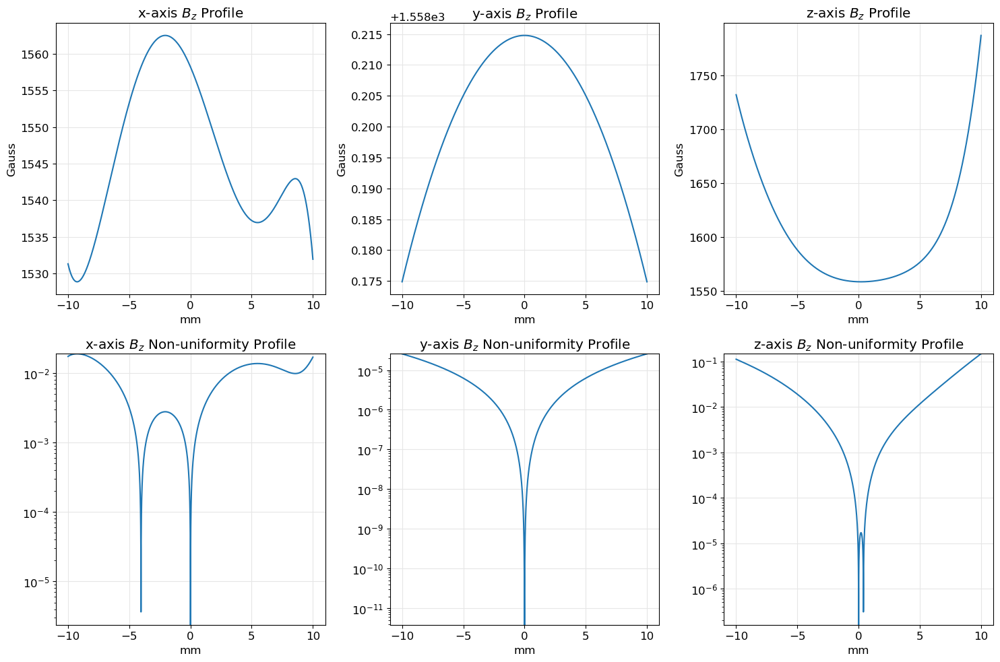

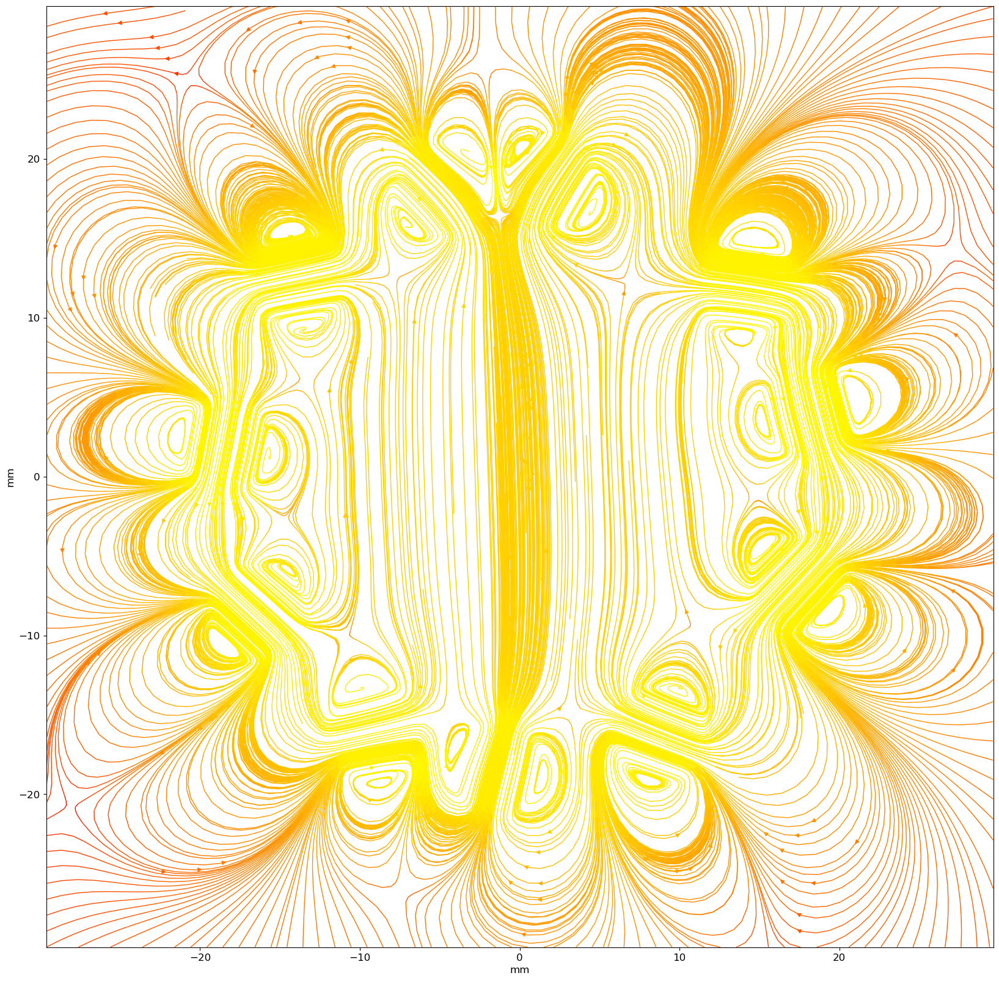

In [3]:
from maggeometry import noisy_halbach_cylinder
from maghelper import get_field_on_axes, get_nonuniformity, make_flux_stream, centered_sweep_range, get_grid_nonuniformity, make_grid

x = [ 3.704e+01,  6.000e+00,  2.100e+02,  1.060e+01]
D, c_d, c_h, N = x
# Br = 0.69e3
Br=1.09e3
magnets = noisy_halbach_cylinder(Br, 0, c_d, c_h, D, int(round(N)), 0, 5, 0, 5, alternate=True)
sens_len = 10
get_field_on_axes(magnets, [[-sens_len, sens_len], [-sens_len, sens_len], [-sens_len, sens_len]], True)

b_len = D*0.8
x_bounds = [-b_len, b_len]
z_bounds = [-b_len, b_len]
make_flux_stream(magnets, x_bounds, z_bounds, [])

On x-axis:
Maximum B-field: 8.826 G
Central B-field: 8.812 G
Min nonuniformity: 0.0
Max nonuniformity:0.0016765358791990107


On y-axis:
Maximum B-field: 8.812 G
Central B-field: 8.812 G
Min nonuniformity: 0.0
Max nonuniformity:5.6090713738143405e-06


On z-axis:
Maximum B-field: 8.966 G
Central B-field: 8.812 G
Min nonuniformity: 0.0
Max nonuniformity:0.017459935670867607


Uniform region width with threshold 1e-06: x = 0.019 cm, y = 0.849 cm, z = 0.003 cm


/Users/nelson/Documents/quantum/quantum_notes/projects/b_field/simulations/b-field-uniformity/maghelper.py:163: UserWarning: Attempt to set non-positive ylim on a log-scaled axis will be ignored.
  axs[3].set_ylim(x_min_nonuniformity - 1e-7, x_max_nonuniformity + 1e-7)
/Users/nelson/Documents/quantum/quantum_notes/projects/b_field/simulations/b-field-uniformity/maghelper.py:168: UserWarning: Attempt to set non-positive ylim on a log-scaled axis will be ignored.
  axs[4].set_ylim(y_min_nonuniformity - 1e-7, y_max_nonuniformity + 1e-7)
/Users/nelson/Documents/quantum/quantum_notes/projects/b_field/simulations/b-field-uniformity/maghelper.py:173: UserWarning: Attempt to set non-positive ylim on a log-scaled axis will be ignored.
  axs[5].set_ylim(z_min_nonuniformity - 1e-7, z_max_nonuniformity + 1e-7)


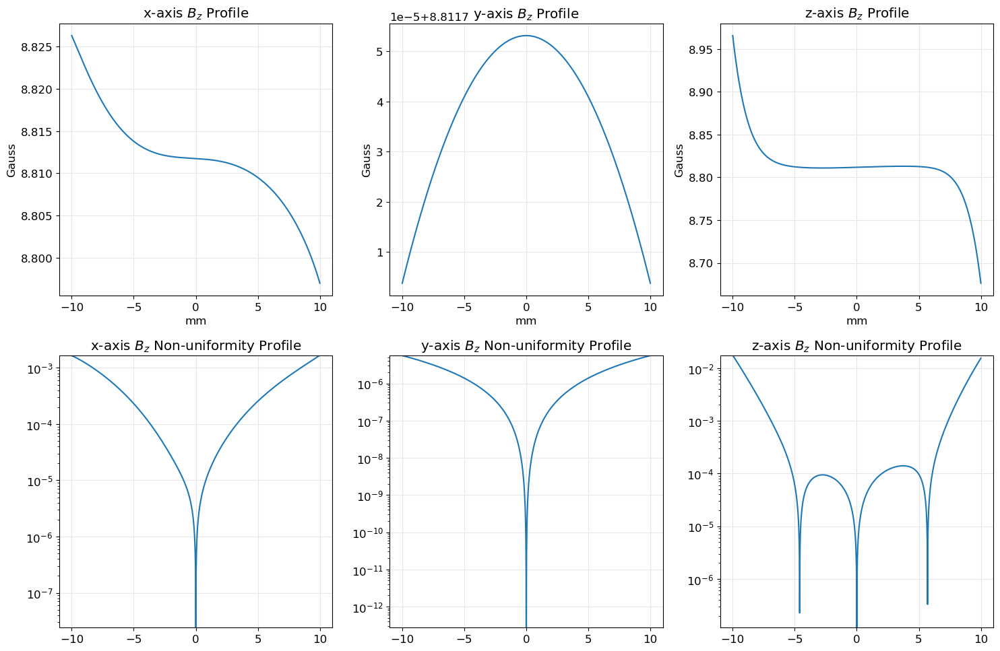

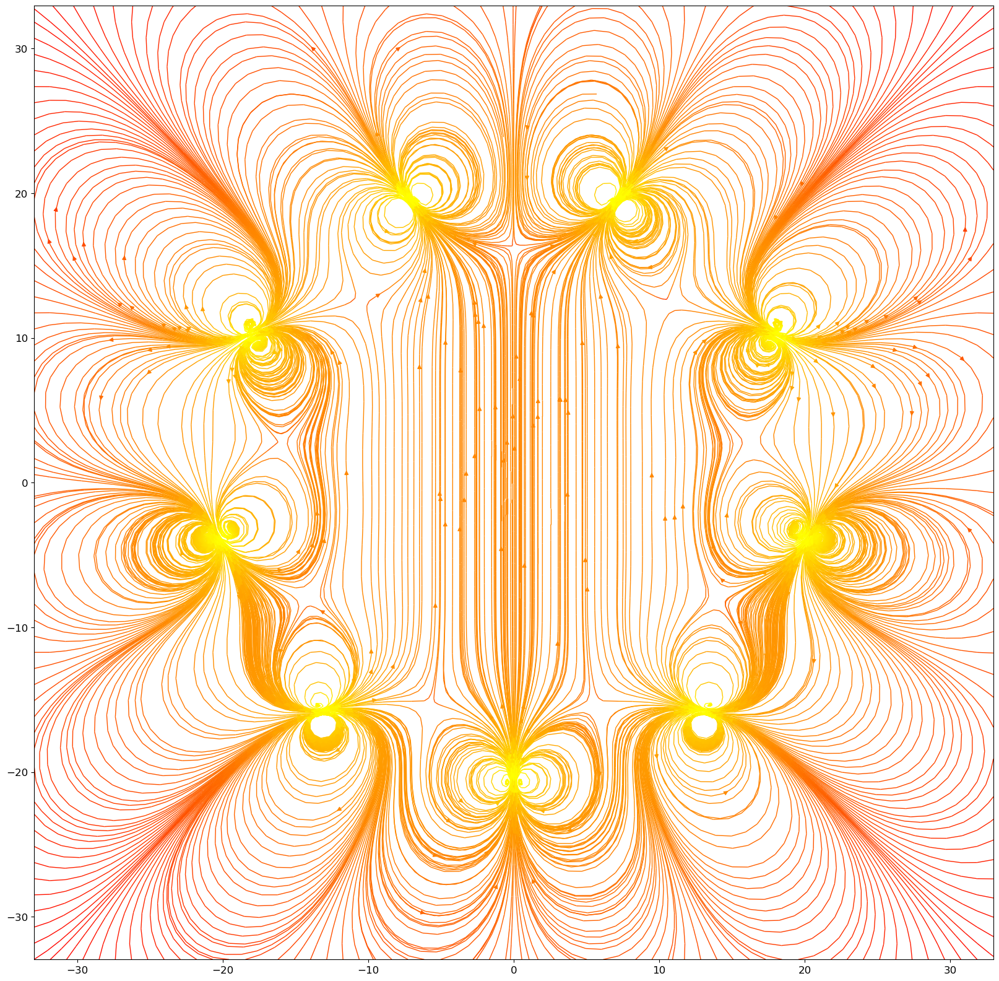

In [2]:
from maggeometry import noisy_halbach_cylinder
from maghelper import get_field_on_axes, get_nonuniformity, make_flux_stream, centered_sweep_range, get_grid_nonuniformity, make_grid

x = [ 41.19644161,   1.2, 300, 9]
D, c_d, c_h, N = x

Br = 230
sd_Br = 0.01*Br
magnets = noisy_halbach_cylinder(Br, sd_Br, c_d, c_h, D, int(round(N)), 0, 0, 0, 0, alternate=True)
sens_len = 10
get_field_on_axes(magnets, [[-sens_len, sens_len], [-sens_len, sens_len], [-sens_len, sens_len]], True)

b_len = D*0.8
x_bounds = [-b_len, b_len]
z_bounds = [-b_len, b_len]
make_flux_stream(magnets, x_bounds, z_bounds, [])

In [11]:
import numpy as np
from maggeometry import noisy_halbach_cylinder, halbach_cylinder
from maghelper import get_field_on_axes, get_nonuniformity, make_flux_stream, centered_sweep_range, get_grid_nonuniformity, make_grid

grid_res = 101
grid = make_grid([-10, 10], [-10, 10], grid_res)

x = [ 41.19644161,   1.2, 300]
D, c_d, c_h= x
Br = 230
sd_Br = 0.01*Br

shots = 100
Nmin = 5
Nmax = 11
res_rem_noise_only = []
for N in range(Nmin, Nmax+1):
    curstep = []
    for s in range(shots):
        magnets = noisy_halbach_cylinder(Br, sd_Br, c_d, c_h, D, int(round(N)), 0, 0, 0, 0, alternate=True)
        grid_field, center_field, av_nonuniformity, max_abs_nonuniformity = get_grid_nonuniformity(magnets, grid, grid_res)
        curstep.append(av_nonuniformity)
#     print(curstep)
    res_rem_noise_only.append(np.mean(curstep))
print(res_rem_noise_only)

res_rem_and_pos_noise = []
for N in range(Nmin, Nmax+1):
    curstep = []
    for s in range(shots):
        magnets = noisy_halbach_cylinder(Br, sd_Br, c_d, c_h, D, int(round(N)), 0, 1, 0, 1, alternate=True)
        grid_field, center_field, av_nonuniformity, max_abs_nonuniformity = get_grid_nonuniformity(magnets, grid, grid_res)
        curstep.append(av_nonuniformity)
#     print(curstep)
    res_rem_and_pos_noise.append(np.mean(curstep))
print(res_rem_and_pos_noise)

gold_standard = []
for N in range(Nmin, Nmax+1):
    curstep = []
    magnets = halbach_cylinder(Br, c_d, c_h, D, int(round(N)), alternate=True)
    grid_field, center_field, av_nonuniformity, max_abs_nonuniformity = get_grid_nonuniformity(magnets, grid, grid_res)
    gold_standard.append(av_nonuniformity)
print(gold_standard)

[0.0018781242999117223, 0.01438409156494741, 0.0011659986374758442, 0.0037941453999839124, 0.0010281761820206885, 0.0014034174850893555, 0.0009411347001046826]
[0.008865743877629432, 0.01710833271949424, 0.007698918740080632, 0.007940077836203874, 0.00740009965746791, 0.006398088432314556, 0.006183004058101428]
[0.0008028148198722541, 0.014084734540525107, 4.772506742746478e-05, 0.0033282804460298674, 4.162541319123247e-06, 0.000802747537989042, 1.7292053020723075e-06]


[ 5  6  7  8  9 10 11]


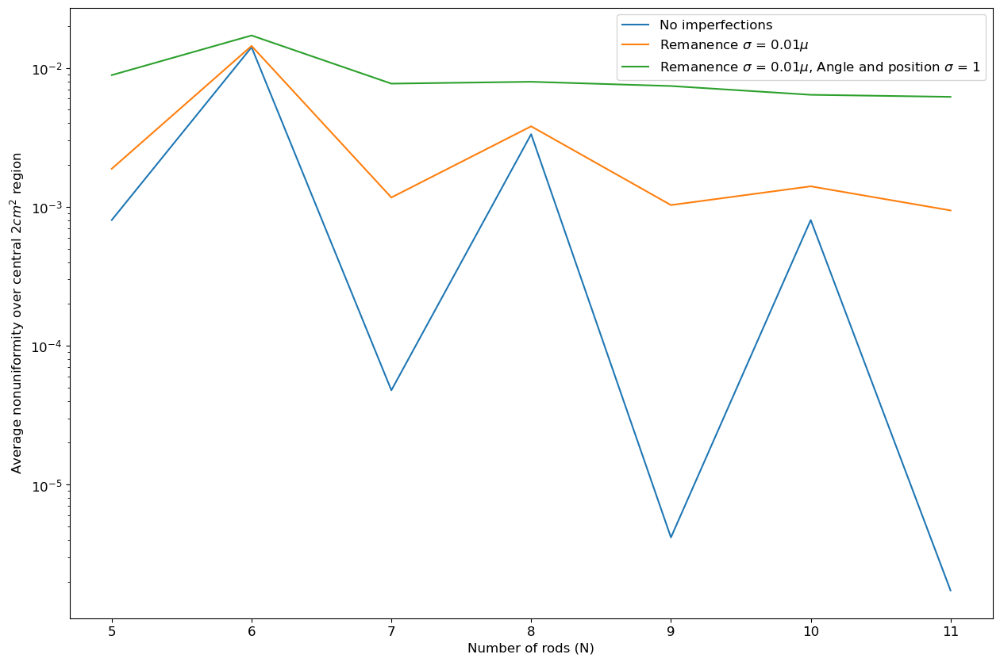

In [20]:
import matplotlib.pyplot as plt

Nrange = np.arange(Nmin, Nmax+1)
print(Nrange)

plt.figure(figsize=(15,10))
plt.plot(Nrange, gold_standard, label="No imperfections")
plt.plot(Nrange, res_rem_noise_only, label=r"Remanence $\sigma$ = 0.01$\mu$")
plt.plot(Nrange, res_rem_and_pos_noise, label=r"Remanence $\sigma$ = 0.01$\mu$, Angle and position $\sigma$ = 1")
plt.yscale("log")
plt.ylabel("Average nonuniformity over central 2$cm^2$ region")
plt.xlabel("Number of rods (N)")
plt.legend()

[0.00107751 0.00111301 0.00111295 0.00111295 0.00111295 0.00111295
 0.00111295 0.00111295 0.00111295 0.00111295 0.00111295 0.00111295
 0.00111295 0.00111295]


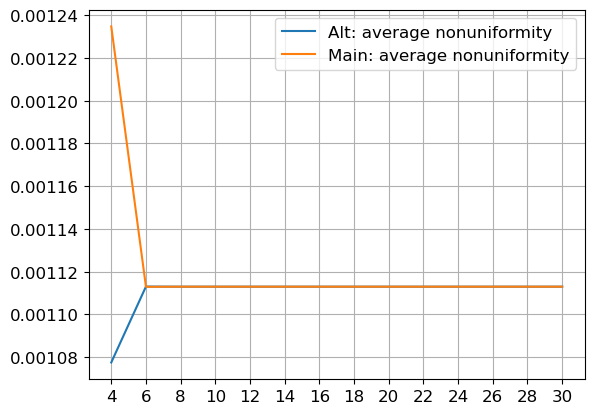

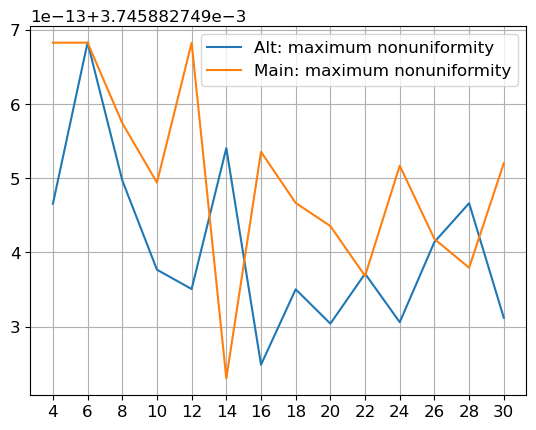

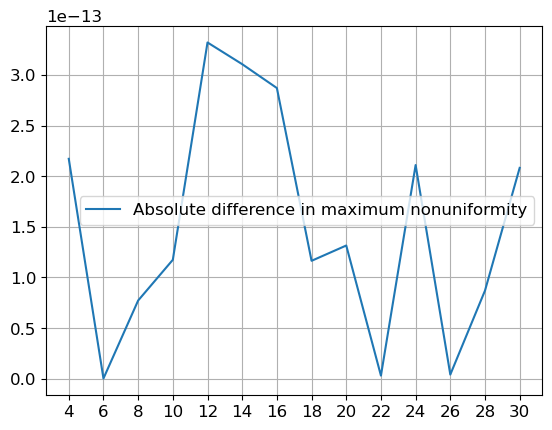

In [36]:
from maggeometry import noisy_halbach_cylinder, halbach_cylinder
from maghelper import get_field_on_axes, get_nonuniformity, make_flux_stream, centered_sweep_range, get_grid_nonuniformity, make_grid
import matplotlib.pyplot as plt
import numpy as np
grid_res = 101
grid = make_grid([-10, 10], [-10, 10], grid_res)

confs=[{'Br': 1090.0, 'c_d': 4.0, 'c_h': 210.0, 'D': 44.0, 'N': 6, 'av': 4.098248651706086e-06, 'max': 1.4186101067324661e-05, 'Bcenter': 315.07733045782635}]

best_conf = confs[0]
magnets = halbach_cylinder(best_conf["Br"],
                           1,
                           best_conf["c_h"],
                           best_conf["D"],
                           best_conf["N"],
                           False)
D = 250
c_d = best_conf["c_d"]
c_h = best_conf["c_h"]
Br = best_conf["Br"]
Nmin = 4
Nmax = 30
alt = []
main = []
for N in range(Nmin, Nmax+1, 2):
    curstep = []
    magnets_alt = halbach_cylinder(Br, c_d, c_h, D, int(round(N)), alternate=True)
    magnets = halbach_cylinder(Br, c_d, c_h, D, int(round(N)), alternate=False)
    alt_grid_field, alt_center_field, alt_av_nonuniformity, alt_max_abs_nonuniformity = get_grid_nonuniformity(magnets_alt, grid, grid_res)
    alt.append([alt_center_field, alt_av_nonuniformity, alt_max_abs_nonuniformity])
    grid_field, center_field, av_nonuniformity, max_abs_nonuniformity = get_grid_nonuniformity(magnets, grid, grid_res)
    main.append([center_field, av_nonuniformity, max_abs_nonuniformity])
# D = best_conf["D"]
# sens_len = 10
# get_field_on_axes(magnets, [[-sens_len, sens_len], [-sens_len, sens_len], [-sens_len, sens_len]], True)
n_range= np.arange(Nmin, Nmax+1, 2)
alt = np.array(alt)
main = np.array(main)
print(alt[:,1])
plt.xticks(range(Nmin, Nmax+1, 2))
plt.grid()
plt.plot(n_range, alt[:, 1], label = "Alt: average nonuniformity")
plt.plot(n_range, main[:, 1], label = "Main: average nonuniformity")
plt.legend()
plt.figure()
plt.xticks(range(Nmin, Nmax+1, 2))
plt.grid()
plt.plot(n_range, alt[:, 2], label = "Alt: maximum nonuniformity")
plt.plot(n_range, main[:, 2], label = "Main: maximum nonuniformity")
plt.legend()
plt.figure()
plt.xticks(range(Nmin, Nmax+1, 2))
plt.grid()
plt.plot(n_range, np.abs(alt[:, 2]-main[:, 2]), label = "Absolute difference in maximum nonuniformity")
plt.legend()

In [1]:
from maggeometry import noisy_halbach_cylinder, halbach_cylinder
from maghelper import get_field_on_axes, get_nonuniformity, make_flux_stream, centered_sweep_range, get_grid_nonuniformity, make_grid
import matplotlib.pyplot as plt
import numpy as np
import magpylib as magpy

confs=[{'Br': 1090.0, 'c_d': 4.0, 'c_h': 210.0, 'D': 44.0, 'N': 6, 'av': 4.098248651706086e-06, 'max': 1.4186101067324661e-05, 'Bcenter': 315.07733045782635}]

best_conf = confs[0]
magnets = halbach_cylinder(best_conf["Br"],
                           1,
                           best_conf["c_h"],
                           best_conf["D"],
                           best_conf["N"],
                           False)
magpy.show(magnets, backend = 'plotly')